In [11]:
%matplotlib inline
import pandas as pd
import numpy as np
from scipy import signal
import numpy.polynomial.polynomial as poly
import numpy.ma as ma
from netCDF4 import Dataset
import xarray as xr
import matplotlib.pyplot as plt
import matplotlib
from matplotlib import pyplot
from matplotlib.ticker import FuncFormatter
from glob import glob
#import cartopy.crs as ccrs
from IPython.display import display
#from cartopy.util import add_cyclic_point
#import cartopy
#import cartopy.crs as ccrs
#from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter
from scipy.interpolate import interp2d
#map_projection = ccrs.Mollweide
import seaborn as sns
import statsmodels.api as sm
import matplotlib.cm as cm
from scipy import stats
import contourpy
from shapely.geometry import Point
from shapely.geometry.polygon import Polygon
import cartopy.crs as ccrs


In [12]:
#calculate volume-weighted species

data = xr.open_dataset('/net/fs09/d0/qdzhu/result/Nicole_aquaQPC6_f09_AveChem_LBC_IC/run/AveChem_LBC_IC.i.nc')
lat = data['lat'].values
lon = data['lon'].values
lev = data['lev'].values
lev = lev[8:]
spcs = ['OH','CH4_CHML','jo3_a','MASS_trop','volume','LNO_PROD','H2O','CO','O3','NO','NO2']#,'OH_budget','OH_budget_freq']

#output_strs = ['FC2000','FC2000_SST_plus2','ZonalChem_addMEG_emis','ZonalChem_plus2_addMEG_emis',
#                'ZonalChem_addMEG_emis_SNOx_plus2_emis','ZonalChem_addMEG_plus2_emis_SNOx_plus2_emis',
#               'ZonalChem_plus2_addMEG_plus2_emis',
#              'ZonalChem_addMEG_2Demis','ZonalChem_plus2_addMEG_2Demis',
#                'ZonalChem_addMEG_2Demis_SNOx_plus2_2Demis','ZonalChem_addMEG_plus2_2Demis_SNOx_plus2_2Demis',
#               'ZonalChem_plus2_addMEG_plus2_2Demis']

output_strs = ['FC2000','FC2000_SST_plus2','ZonalChem_addMEG_2Demis','ZonalChem_plus2_addMEG_2Demis',
               'ZonalChem_addMEG_2Demis_SNOx_plus2_2Demis','ZonalChem_addMEG_plus2_2Demis_SNOx_plus2_2Demis',
               'ZonalChem_plus2_addMEG_plus2_2Demis']

spcs_comb = np.zeros((len(output_strs),len(spcs),192,288))

pres_indx = lev<=350

for i in range(len(spcs)):
    for j in range(len(output_strs)):
        if 'FC2000' in output_strs[j]:

            aqua_oh = np.load('../Output/camchem_{}_3d/{}_comb_eyear_32.npy'.format(output_strs[j],spcs[i]))
            aqua_volume = np.load('../Output/camchem_{}_3d/{}_comb_eyear_32.npy'.format(output_strs[j],'volume_full'))
        else:
            aqua_oh = np.load('../Output/aquas_{}_3d/{}_comb.npy'.format(output_strs[j],spcs[i]))
            aqua_volume = np.load('../Output/aquas_{}_3d/{}_comb.npy'.format(output_strs[j],'volume_full'))
        aqua_volume[:,pres_indx,:,:] = np.nan
        aqua_oh = np.nansum(aqua_oh*aqua_volume,axis=1)/np.nansum(aqua_volume,axis=1)
        spcs_comb[j,i,:,:] = aqua_oh[0,:,:]


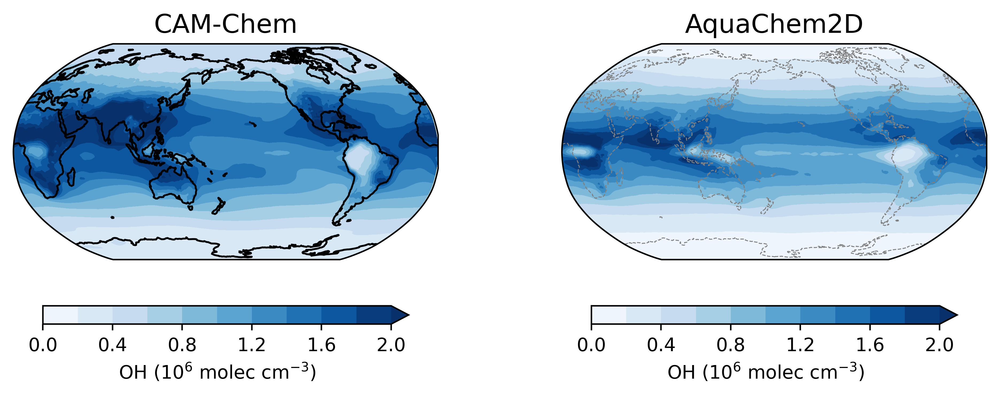

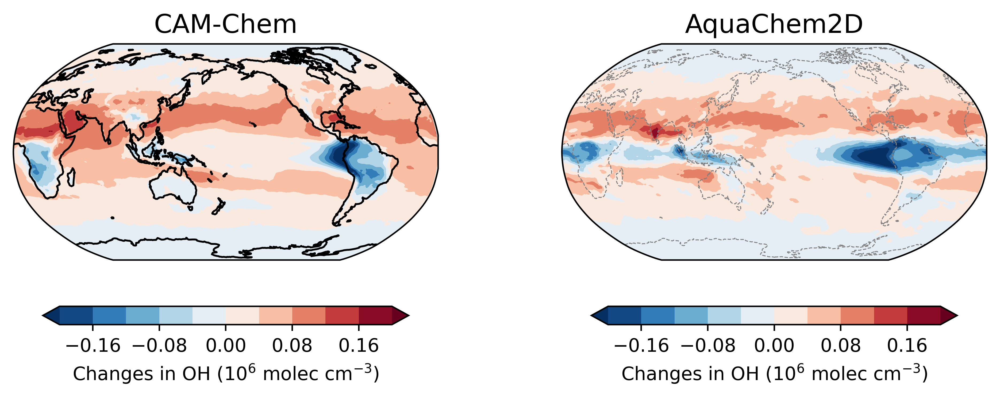

In [17]:
base_indxs = [0,2]
warming_indxs = [1,6]
labels = ['CAM-Chem','AquaChem2D']
indxs = [0,2]
fig = plt.figure(figsize=(15,3),dpi=500)
for i in range(2):
    ax = fig.add_subplot(131+i,projection=ccrs.Robinson(central_longitude=180),facecolor='white',frameon=True)
    plot=plt.contourf(lon,lat,spcs_comb[base_indxs[i],0,:,:]/1e6,levels=np.linspace(0,2,11),
                      cmap=plt.cm.Blues,transform=ccrs.PlateCarree(),extend='max') 

    cb=plt.colorbar(plot,ax=ax,shrink=0.8, orientation = 'horizontal',label='OH (10$^6$ molec cm$^{-3}$)')
    ax.set_title(labels[i],fontsize=14)
    #ax.set_title(output_strs[i],fontsize=8)
    if i == 0:
        ax.coastlines()
    else:
        ax.coastlines(linestyle='--',color='gray',linewidth=0.5)
        
fig = plt.figure(figsize=(15,3),dpi=500)

for i in range(2): 
    ax = fig.add_subplot(131+i,projection=ccrs.Robinson(central_longitude=180),facecolor='white',frameon=True)
    plot=plt.contourf(lon,lat,spcs_comb[warming_indxs[i],0,:,:]/1e6 - spcs_comb[base_indxs[i],0,:,:]/1e6,levels=np.linspace(-0.2,0.2,11),
                      cmap=plt.cm.RdBu_r,transform=ccrs.PlateCarree(),extend='both') 

    cb=plt.colorbar(plot,ax=ax,shrink=0.8, orientation = 'horizontal',label='Changes in OH (10$^6$ molec cm$^{-3}$)')
    #plt.title('Year {}, month {}'.format(1950+i_year, 1+i_month))
    ax.set_title(labels[i],fontsize=14)
    #ax.set_title(output_strs[i],fontsize=8)
    if i == 0:
        ax.coastlines()
    else:
        ax.coastlines(linestyle='--',color='gray',linewidth=0.5)

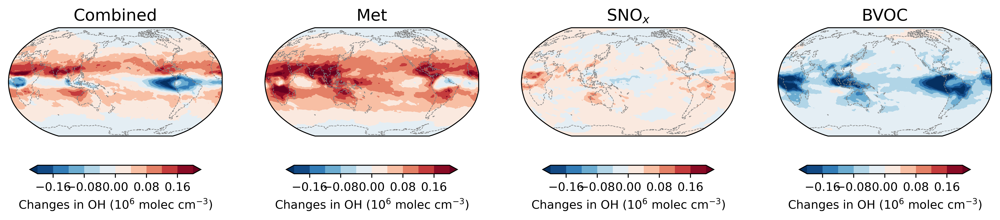

In [4]:
base_indxs = [2,2,3,4]
warming_indxs = [5,3,4,5]
labels = ['Combined','Met','SNO$_x$','BVOC']

#labels = ['CAM-Chem','AquaChem2D']
indxs = [0,2]
fig = plt.figure(figsize=(15,3),dpi=500)

for i in range(4): 
    ax = fig.add_subplot(141+i,projection=ccrs.Robinson(central_longitude=180),facecolor='white',frameon=True)
    plot=plt.contourf(lon,lat,spcs_comb[warming_indxs[i],0,:,:]/1e6 - spcs_comb[base_indxs[i],0,:,:]/1e6,levels=np.linspace(-0.2,0.2,11),
                      cmap=plt.cm.RdBu_r,transform=ccrs.PlateCarree(),extend='both') 

    cb=plt.colorbar(plot,ax=ax,shrink=0.8, orientation = 'horizontal',label='Changes in OH (10$^6$ molec cm$^{-3}$)')
    #plt.title('Year {}, month {}'.format(1950+i_year, 1+i_month))
    ax.set_title(labels[i],fontsize=14)
    #ax.set_title(output_strs[i],fontsize=8)
    ax.coastlines(linestyle='--',color='gray',linewidth=0.5)

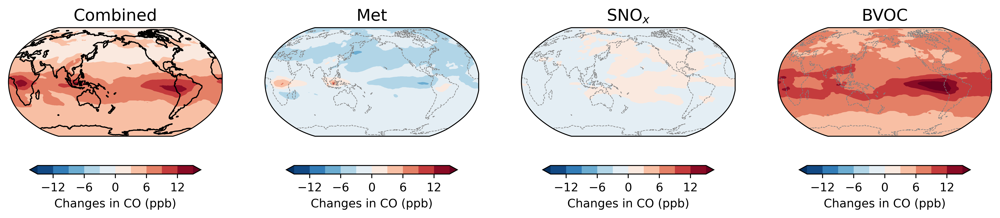

In [62]:
base_indxs = [2,2,3,4]
warming_indxs = [5,3,4,5]
labels = ['Combined','Met','SNO$_x$','BVOC']
spc_indx = spcs.index('CO')
#labels = ['CAM-Chem','AquaChem2D']
indxs = [0,2]
fig = plt.figure(figsize=(15,3),dpi=500)

for i in range(4): 
    ax = fig.add_subplot(141+i,projection=ccrs.Robinson(central_longitude=180),facecolor='white',frameon=True)
    plot=plt.contourf(lon,lat,spcs_comb[warming_indxs[i],spc_indx,:,:]*1e9 - spcs_comb[base_indxs[i],spc_indx,:,:]*1e9,levels=np.linspace(-15,15,11),
                      cmap=plt.cm.RdBu_r,transform=ccrs.PlateCarree(),extend='both') 
    #if i ==1:
    cb=plt.colorbar(plot,ax=ax,shrink=0.8, orientation = 'horizontal',label='Changes in CO (ppb)')
    #plt.title('Year {}, month {}'.format(1950+i_year, 1+i_month))
    ax.set_title(labels[i],fontsize=14)
    #ax.set_title(output_strs[i],fontsize=8)
    if i == 0:
        ax.coastlines()
    else:
        ax.coastlines(linestyle='--',color='gray',linewidth=0.5)

In [ ]:
base_indxs = [2,2,3,4]
warming_indxs = [5,3,4,5]
labels = ['Combined','Met','SNO$_x$','BVOC']
spc_indx = spcs.index('CO')
#labels = ['CAM-Chem','AquaChem2D']
indxs = [0,2]
fig = plt.figure(figsize=(15,3),dpi=500)

for i in range(4): 
    ax = fig.add_subplot(141+i,projection=ccrs.Robinson(central_longitude=180),facecolor='white',frameon=True)
    plot=plt.contourf(lon,lat,spcs_comb[warming_indxs[i],spc_indx,:,:]*1e9 - spcs_comb[base_indxs[i],spc_indx,:,:]*1e9,levels=np.linspace(-15,15,11),
                      cmap=plt.cm.RdBu_r,transform=ccrs.PlateCarree(),extend='both') 
    #if i ==1:
    cb=plt.colorbar(plot,ax=ax,shrink=0.8, orientation = 'horizontal',label='Changes in H$_2$O (g/kg)')
    #plt.title('Year {}, month {}'.format(1950+i_year, 1+i_month))
    ax.set_title(labels[i],fontsize=14)
    #ax.set_title(output_strs[i],fontsize=8)
    if i == 0:
        ax.coastlines()
    else:
        ax.coastlines(linestyle='--',color='gray',linewidth=0.5)

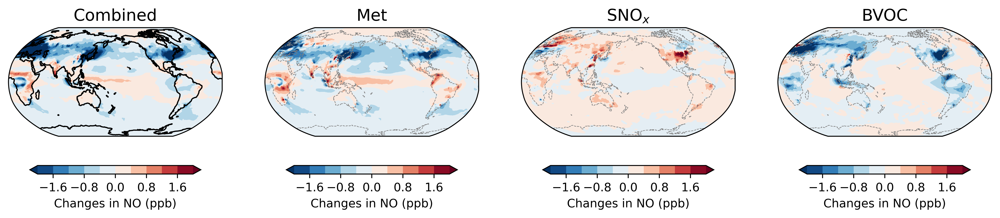

In [17]:
base_indxs = [2,2,3,4]
warming_indxs = [5,3,4,5]
labels = ['Combined','Met','SNO$_x$','BVOC']
spc_indx = spcs.index('NO')
#labels = ['CAM-Chem','AquaChem2D']
indxs = [0,2]
fig = plt.figure(figsize=(15,3),dpi=500)

for i in range(4): 
    ax = fig.add_subplot(141+i,projection=ccrs.Robinson(central_longitude=180),facecolor='white',frameon=True)
    plot=plt.contourf(lon,lat,spcs_comb[warming_indxs[i],spc_indx,:,:]*1e12 - spcs_comb[base_indxs[i],spc_indx,:,:]*1e12,levels=np.linspace(-2,2,11),
                      cmap=plt.cm.RdBu_r,transform=ccrs.PlateCarree(),extend='both') 
    #if i ==1:
    cb=plt.colorbar(plot,ax=ax,shrink=0.8, orientation = 'horizontal',label='Changes in NO (ppb)')
    #plt.title('Year {}, month {}'.format(1950+i_year, 1+i_month))
    ax.set_title(labels[i],fontsize=14)
    #ax.set_title(output_strs[i],fontsize=8)
    if i == 0:
        ax.coastlines()
    else:
        ax.coastlines(linestyle='--',color='gray',linewidth=0.5)

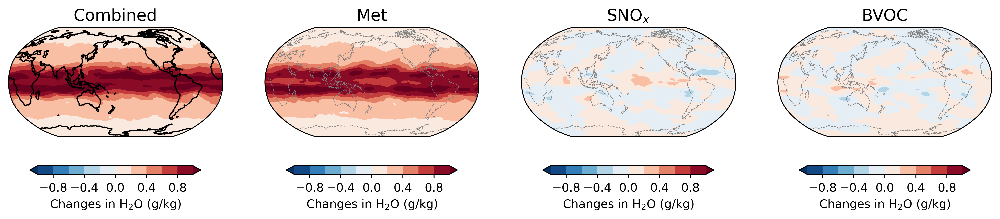

In [70]:
base_indxs = [2,2,3,4]
warming_indxs = [5,3,4,5]
labels = ['Combined','Met','SNO$_x$','BVOC']
spc_indx = spcs.index('H2O')
#labels = ['CAM-Chem','AquaChem2D']
indxs = [0,2]
fig = plt.figure(figsize=(15,3),dpi=500)

for i in range(4): 
    ax = fig.add_subplot(141+i,projection=ccrs.Robinson(central_longitude=180),facecolor='white',frameon=True)
    plot=plt.contourf(lon,lat,spcs_comb[warming_indxs[i],spc_indx,:,:]*18/28.9647*1e3 - spcs_comb[base_indxs[i],spc_indx,:,:]*18/28.9647*1e3,levels=np.linspace(-1,1,11),
                      cmap=plt.cm.RdBu_r,transform=ccrs.PlateCarree(),extend='both') 
    #if i ==1:-2
    cb=plt.colorbar(plot,ax=ax,shrink=0.8, orientation = 'horizontal',label='Changes in H$_2$O (g/kg)')
    #plt.title('Year {}, month {}'.format(1950+i_year, 1+i_month))
    ax.set_title(labels[i],fontsize=14)
    #ax.set_title(output_strs[i],fontsize=8)
    if i == 0:
        ax.coastlines()
    else:
        ax.coastlines(linestyle='--',color='gray',linewidth=0.5)

In [ ]:
base_indxs = [2,2,3,4]
warming_indxs = [5,3,4,5]
labels = ['Combined','Met','SNO$_x$','BVOC']
spc_indx = spcs.index('NO')
#labels = ['CAM-Chem','AquaChem2D']
indxs = [0,2]
fig = plt.figure(figsize=(15,3),dpi=500)

for i in range(4): 
    ax = fig.add_subplot(141+i,projection=ccrs.Robinson(central_longitude=180),facecolor='white',frameon=True)
    plot=plt.contourf(lon,lat,spcs_comb[warming_indxs[i],spc_indx,:,:]*18/28.9647*1e3 - spcs_comb[base_indxs[i],spc_indx,:,:]*18/28.9647*1e3,levels=np.linspace(-1,1,11),
                      cmap=plt.cm.RdBu_r,transform=ccrs.PlateCarree(),extend='both') 
    #if i ==1:-2
    cb=plt.colorbar(plot,ax=ax,shrink=0.8, orientation = 'horizontal',label='Changes in H$_2$O (g/kg)')
    #plt.title('Year {}, month {}'.format(1950+i_year, 1+i_month))
    ax.set_title(labels[i],fontsize=14)
    #ax.set_title(output_strs[i],fontsize=8)
    if i == 0:
        ax.coastlines()
    else:
        ax.coastlines(linestyle='--',color='gray',linewidth=0.5)

In [5]:
budget_terms = ['OH_budget','OH_budget_freq']#,'OH_budget','OH_budget_freq']

budget_comb = np.zeros((len(output_strs),13,192,288))
budget_freq_comb = np.zeros((len(output_strs),13,192,288))

budget_global = np.zeros((len(output_strs),13))
budget_freq_global = np.zeros((len(output_strs),13))

pres_indx = lev<=350

for i in range(len(budget_terms)):
    for j in range(len(output_strs)):
        if 'FC2000' in output_strs[j]:
            aqua_oh = np.load('../Output/camchem_{}_3d/{}_comb.npy'.format(output_strs[j],budget_terms[i]))
            aqua_volume = np.load('../Output/camchem_{}_3d/{}_comb_eyear_32.npy'.format(output_strs[j],'MASS_trop'))
        else:
            aqua_oh = np.load('../Output/aquas_{}_3d/{}_comb.npy'.format(output_strs[j],budget_terms[i]))
            aqua_volume = np.load('../Output/aquas_{}_3d/{}_comb.npy'.format(output_strs[j],'MASS_trop'))
        aqua_volume[:,pres_indx,:,:] = np.nan
        aqua_oh_mass = np.zeros((13,192,288))
        lat_indx = (lat>=-60) & (lat<=60)

        this_budget_global = np.zeros(13)
        for k in range(13):
            aqua_oh_mass[k,:,:] = np.nansum(aqua_oh[:,k,:,:,:]*aqua_volume,axis=1)/np.nansum(aqua_volume,axis=1)
            #this_budget_sum[k] = np.nansum(aqua_oh[:,k,:,:,:]*aqua_volume)*1e-12*365*86400/(6.02e23)
            this_budget_global[k] = np.nansum(aqua_oh[0,k,:,lat_indx,:]*aqua_volume[0,:,lat_indx,:])/np.nansum(aqua_volume[0,:,lat_indx,:])
        #for k in range(13):
        #    if budget_terms[i] == 'OH_budget_freq':
        #        aqua_oh_mass[k,:,:] = np.nansum(aqua_oh[:,k,:,:,:]*aqua_volume,axis=1)/np.nansum(aqua_volume,axis=1)
        #    elif budget_terms[i] == 'OH_budget':
        #        aqua_oh_mass[k,:,:] = np.nansum(aqua_oh[:,k,:,:,:]*aqua_volume,axis=1)/(6.02e23) #mol/s #*1e-12*365*86400/(6.02e23)

        
        if budget_terms[i] == 'OH_budget':
            budget_comb[j,:,:,:] = aqua_oh_mass
            budget_global[j,:] = this_budget_global
            
        elif budget_terms[i] == 'OH_budget_freq':
            budget_freq_comb[j,:,:,:] = aqua_oh_mass
            budget_freq_global[j,:] = this_budget_global

In [6]:
budget_labels = ['OH PROD','OH Loss','CH$_4$+OH','CO+OH','HOy+OH',
          'ISOP+OH','C1VOC+OH','C2VOC+OH','NOy+OH',
          'O$_3$+HO$_2$','2x(O$^1$D+H$_2$O)','NO+HO$_2$','2xj(H$_2$O$_2$)']
cls_labels = ['Prod Total','Loss Total','Loss','Loss','Loss',
             'Loss','Loss','Loss','Loss',
             'Prod','Prod','Prod','Prod']

In [35]:
np.max(budget_comb[base_indxs[i],spc_indx,:,:])

700.175452409539

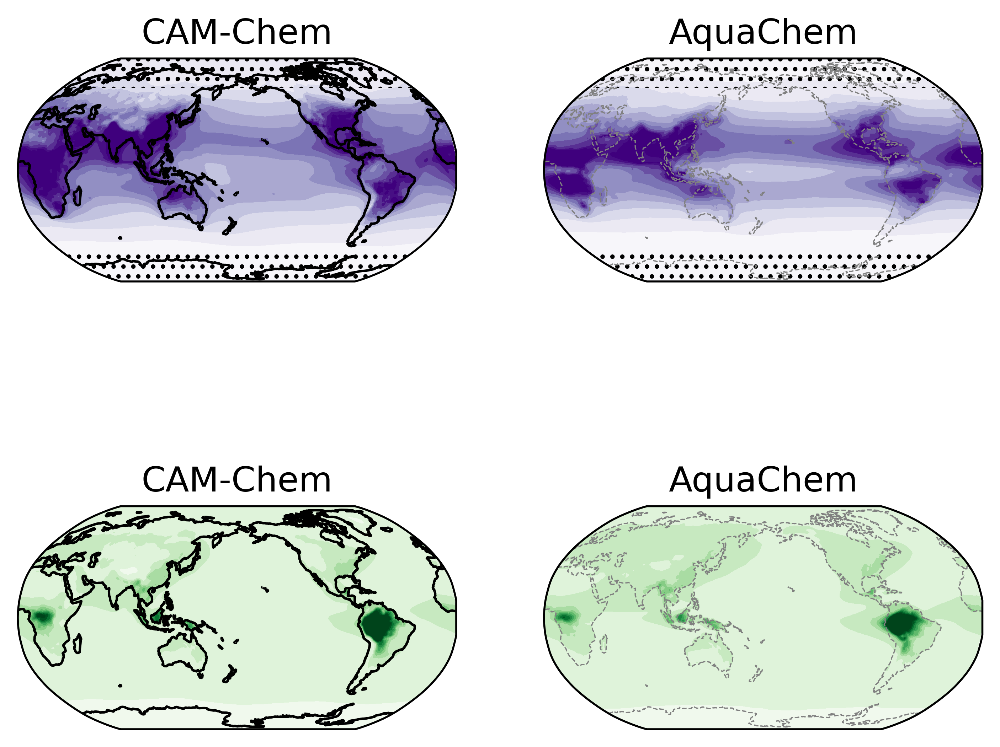

In [10]:
base_indxs = [0,2]
warming_indxs = [1,6]
labels = ['CAM-Chem','AquaChem']
indxs = [0,2]
spc_indx = budget_labels.index('OH PROD')
fig = plt.figure(figsize=(7,6),dpi=500)
for i in range(2):
    ax = fig.add_subplot(221+i,projection=ccrs.Robinson(central_longitude=180),facecolor='white',frameon=True)
    plot=plt.contourf(lon,lat,budget_comb[base_indxs[i],spc_indx,:,:]/1e6,levels=np.linspace(0,2,11),
                      cmap=plt.cm.Purples,transform=ccrs.PlateCarree(),extend='max') 

    #cb=plt.colorbar(plot,ax=ax,shrink=0.8, orientation = 'horizontal',label='OH Production rate (mol/s)')
    #cb=plt.colorbar(plot,ax=ax,shrink=0.8, orientation = 'horizontal',label='OH Production rate (10$^6$ molec cm$^{-3}$ s$^{-1}$)')
    ax.set_title(labels[i],fontsize=14)
    density=3
    filter_indx = np.zeros((192,288))
    lat_indx = (lat>60) | (lat<-60)
    filter_indx[lat_indx,:] = 1
    plt.contourf(
        lon, lat, filter_indx,
        transform=ccrs.PlateCarree(),
        colors='none',
        levels=[.5,1.5],
        hatches=[density*'.',density*'.'],
    )
    #ax.set_title(output_strs[i],fontsize=8)
    if i == 0:
        ax.coastlines()
    else:
        ax.coastlines(linestyle='--',color='gray',linewidth=0.5)
        
spc_indx = budget_labels.index('OH Loss')
#fig = plt.figure(figsize=(10,3),dpi=500)
for i in range(2):
    ax = fig.add_subplot(223+i,projection=ccrs.Robinson(central_longitude=180),facecolor='white',frameon=True)
    plot=plt.contourf(lon,lat,budget_freq_comb[base_indxs[i],spc_indx,:,:],levels=np.linspace(0,4,11),
                      cmap=plt.cm.Greens,transform=ccrs.PlateCarree(),extend='max') 

    #cb=plt.colorbar(plot,ax=ax,shrink=0.8, orientation = 'horizontal',label='OH Loss frequency (s$^{-1}$)')
    ax.set_title(labels[i],fontsize=14)
    #ax.set_title(output_strs[i],fontsize=8)
    if i == 0:
        ax.coastlines()
    else:
        ax.coastlines(linestyle='--',color='gray',linewidth=0.5)

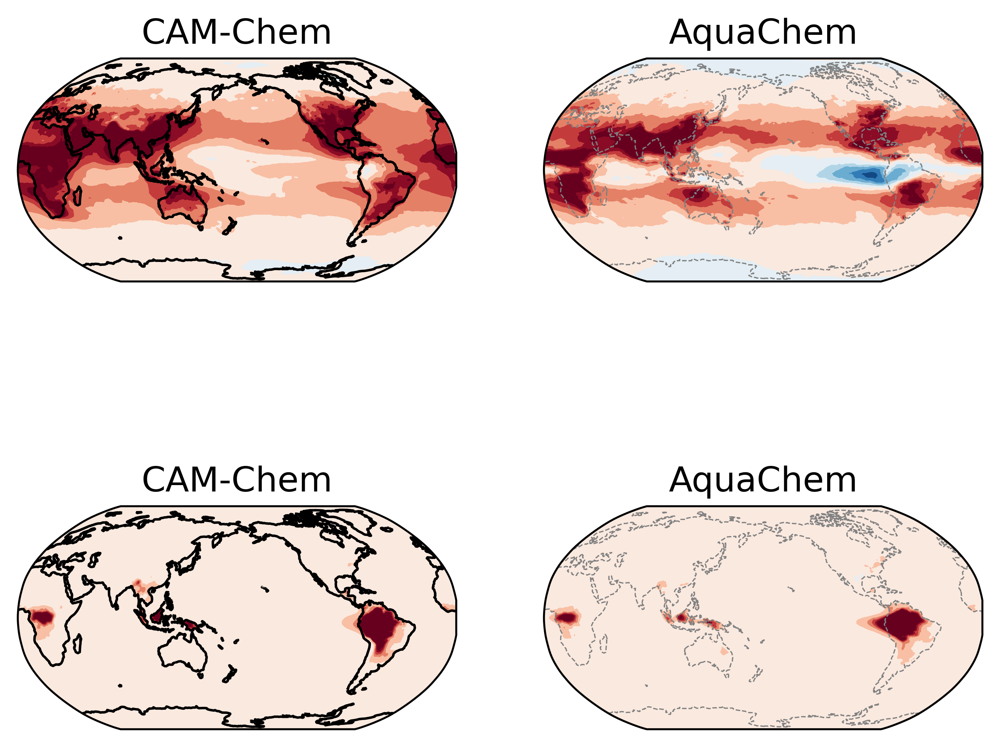

In [11]:
base_indxs = [0,2]
warming_indxs = [1,6]
labels = ['CAM-Chem','AquaChem']
indxs = [0,2]
spc_indx = budget_labels.index('OH PROD')

fig = plt.figure(figsize=(7,6),dpi=500)

for i in range(2): 
    ax = fig.add_subplot(221+i,projection=ccrs.Robinson(central_longitude=180),facecolor='white',frameon=True)
    plot=plt.contourf(lon,lat,budget_comb[warming_indxs[i],spc_indx,:,:]/1e6 - budget_comb[base_indxs[i],spc_indx,:,:]/1e6,levels=np.linspace(-0.2,0.2,11),
                      cmap=plt.cm.RdBu_r,transform=ccrs.PlateCarree(),extend='both') 

    #if i ==0:
    #    cb=plt.colorbar(plot,ax=ax,shrink=0.8, orientation = 'horizontal',label='Changes in OH production rate (10$^6$ molec cm$^{-3}$ s$^{-1}$)',anchor=(1.0,0.0))
    #plt.title('Year {}, month {}'.format(1950+i_year, 1+i_month))
    ax.set_title(labels[i],fontsize=14)
    #ax.set_title(output_strs[i],fontsize=8)
    if i == 0:
        ax.coastlines()
    else:
        ax.coastlines(linestyle='--',color='gray',linewidth=0.5)

#fig = plt.figure(figsize=(10,3),dpi=500)

for i in range(2): 
    ax = fig.add_subplot(223+i,projection=ccrs.Robinson(central_longitude=180),facecolor='white',frameon=True)
    plot=plt.contourf(lon,lat,budget_freq_comb[warming_indxs[i],spc_indx,:,:]- budget_freq_comb[base_indxs[i],spc_indx,:,:],levels=np.linspace(-1,1,11),
                      cmap=plt.cm.RdBu_r,transform=ccrs.PlateCarree(),extend='both') 

    #cb=plt.colorbar(plot,ax=ax,shrink=0.8, orientation = 'horizontal',label='Changes in OH loss frequency (s$^{-1}$)')
    #plt.title('Year {}, month {}'.format(1950+i_year, 1+i_month))
    ax.set_title(labels[i],fontsize=14)
    #ax.set_title(output_strs[i],fontsize=8)
    if i == 0:
        ax.coastlines()
    else:
        ax.coastlines(linestyle='--',color='gray',linewidth=0.5)

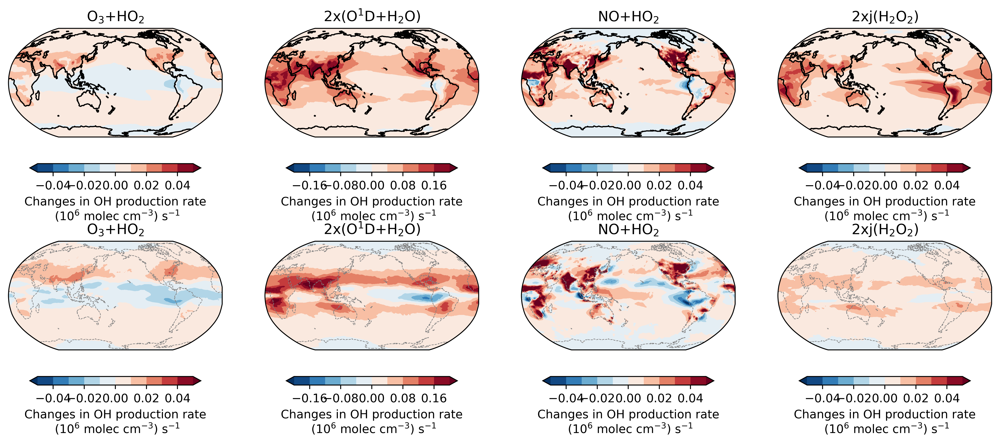

In [13]:
base_indxs = [0,2]
warming_indxs = [1,6]
labels = ['CAM-Chem','AquaChem2D']
indxs = [0,2]
spc_indxs = ['O$_3$+HO$_2$','2x(O$^1$D+H$_2$O)','NO+HO$_2$','2xj(H$_2$O$_2$)']

ranges = [0.05,0.2,0.05,0.05]
fig = plt.figure(figsize=(15,6),dpi=500)

for i in range(2): 
    for j in range(len(spc_indxs)):
        spc_indx = budget_labels.index(spc_indxs[j])
        ax = fig.add_subplot(241+4*i+j,projection=ccrs.Robinson(central_longitude=180),facecolor='white',frameon=True)
        plot=plt.contourf(lon,lat,budget_comb[warming_indxs[i],spc_indx,:,:]/1e6 - budget_comb[base_indxs[i],spc_indx,:,:]/1e6,levels=np.linspace(-ranges[j],ranges[j],11),
                          cmap=plt.cm.RdBu_r,transform=ccrs.PlateCarree(),extend='both') 

        cb=plt.colorbar(plot,ax=ax,shrink=0.8, orientation = 'horizontal',label='Changes in OH production rate\n (10$^6$ molec cm$^{-3}$) s$^{-1}$')
        #plt.title('Year {}, month {}'.format(1950+i_year, 1+i_month))
        #ax.set_title(labels[i],fontsize=14)
        ax.set_title(spc_indxs[j],fontsize=12)
        if i == 0:
            ax.coastlines()
        else:
            ax.coastlines(linestyle='--',color='gray',linewidth=0.5)

    


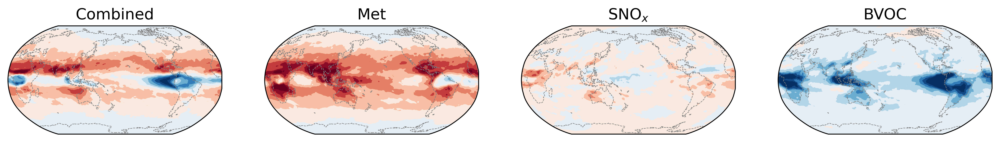

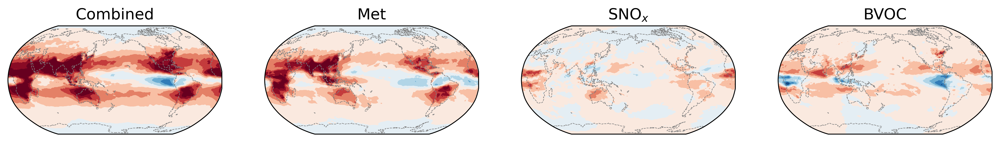

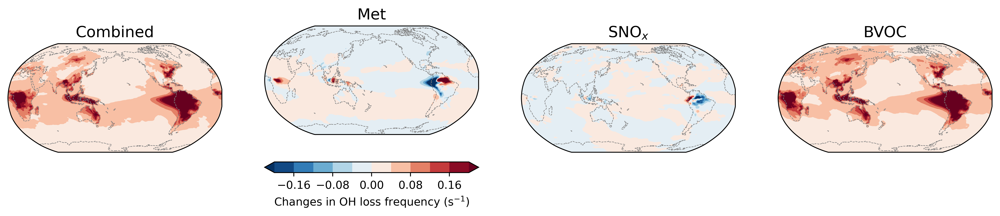

In [10]:
#5 scenarios

base_indxs = [2,2,3,4]
warming_indxs = [5,3,4,5]
labels = ['Combined','Met','SNO$_x$','BVOC']
indxs = [0,2]
fig = plt.figure(figsize=(16,3),dpi=500)

for i in range(4): 
    ax = fig.add_subplot(141+i,projection=ccrs.Robinson(central_longitude=180),facecolor='white',frameon=True)
    plot=plt.contourf(lon,lat,spcs_comb[warming_indxs[i],0,:,:]/1e6 - spcs_comb[base_indxs[i],0,:,:]/1e6,levels=np.linspace(-0.2,0.2,11),
                      cmap=plt.cm.RdBu_r,transform=ccrs.PlateCarree(),extend='both') 

   # if i==1:
   #     cb=plt.colorbar(plot,ax=ax,shrink=0.8, orientation = 'horizontal',label='Changes in OH (10$^6$ molec cm$^{-3}$)')
    #plt.title('Year {}, month {}'.format(1950+i_year, 1+i_month))
    ax.set_title(labels[i],fontsize=14)
    #ax.set_title(output_strs[i],fontsize=8)

    ax.coastlines(linestyle='--',color='gray',linewidth=0.5)
        
spc_indx = budget_labels.index('OH PROD')

fig = plt.figure(figsize=(16,3),dpi=500)

for i in range(4): 
    ax = fig.add_subplot(141+i,projection=ccrs.Robinson(central_longitude=180),facecolor='white',frameon=True)
    plot=plt.contourf(lon,lat,budget_comb[warming_indxs[i],spc_indx,:,:]/1e6 - budget_comb[base_indxs[i],spc_indx,:,:]/1e6,levels=np.linspace(-0.2,0.2,11),
                      cmap=plt.cm.RdBu_r,transform=ccrs.PlateCarree(),extend='both') 
    #if i ==1:
    #cb=plt.colorbar(plot,ax=ax,shrink=1, orientation = 'horizontal',label='Changes in OH production rate (10$^6$ molec cm$^{-3}$ s$^{-1}$)')
    #plt.title('Year {}, month {}'.format(1950+i_year, 1+i_month))
    ax.set_title(labels[i],fontsize=14)
    #ax.set_title(output_strs[i],fontsize=8)

    ax.coastlines(linestyle='--',color='gray',linewidth=0.5)

spc_indx = budget_labels.index('OH Loss')
fig = plt.figure(figsize=(16,3),dpi=500)

for i in range(4): 
    ax = fig.add_subplot(141+i,projection=ccrs.Robinson(central_longitude=180),facecolor='white',frameon=True)
    plot=plt.contourf(lon,lat,budget_freq_comb[warming_indxs[i],spc_indx,:,:]- budget_freq_comb[base_indxs[i],spc_indx,:,:],levels=np.linspace(-0.2,0.2,11),
                      cmap=plt.cm.RdBu_r,transform=ccrs.PlateCarree(),extend='both') 
    if i ==1:
        cb=plt.colorbar(plot,ax=ax,shrink=1, orientation = 'horizontal',label='Changes in OH loss frequency (s$^{-1}$)')
    #plt.title('Year {}, month {}'.format(1950+i_year, 1+i_month))
    ax.set_title(labels[i],fontsize=14)
    #ax.set_title(output_strs[i],fontsize=8)

    ax.coastlines(linestyle='--',color='gray',linewidth=0.5)

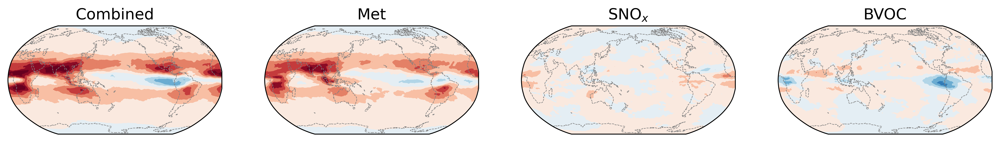

In [9]:


#5 scenarios

base_indxs = [2,2,3,4]
warming_indxs = [5,3,4,5]
labels = ['Combined','Met','SNO$_x$','BVOC']
indxs = [0,2]

spc_indx = budget_labels.index('2x(O$^1$D+H$_2$O)')

fig = plt.figure(figsize=(16,3),dpi=500)

for i in range(4): 
    ax = fig.add_subplot(141+i,projection=ccrs.Robinson(central_longitude=180),facecolor='white',frameon=True)
    plot=plt.contourf(lon,lat,budget_comb[warming_indxs[i],spc_indx,:,:]/1e6 - budget_comb[base_indxs[i],spc_indx,:,:]/1e6,levels=np.linspace(-0.2,0.2,11),
                      cmap=plt.cm.RdBu_r,transform=ccrs.PlateCarree(),extend='both') 
    #if i ==1:
    #cb=plt.colorbar(plot,ax=ax,shrink=1, orientation = 'horizontal',label='Changes in OH production rate (10$^6$ molec cm$^{-3}$ s$^{-1}$)')
    #plt.title('Year {}, month {}'.format(1950+i_year, 1+i_month))
    ax.set_title(labels[i],fontsize=14)
    #ax.set_title(output_strs[i],fontsize=8)
    
    ax.coastlines(linestyle='--',color='gray',linewidth=0.5)


        

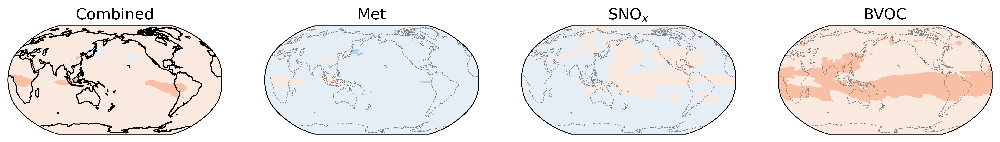

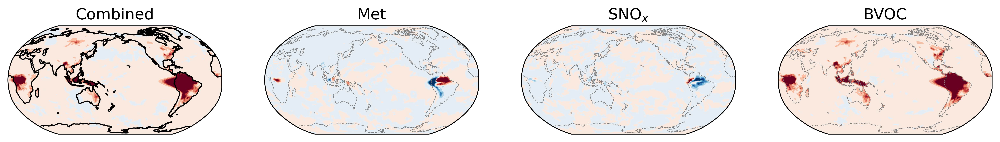

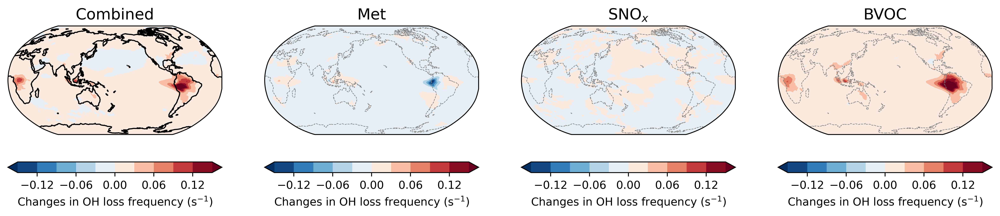

In [20]:
spc_indx = budget_labels.index('CO+OH')
fig = plt.figure(figsize=(16,3),dpi=500)

for i in range(4): 
    ax = fig.add_subplot(141+i,projection=ccrs.Robinson(central_longitude=180),facecolor='white',frameon=True)
    plot=plt.contourf(lon,lat,budget_freq_comb[warming_indxs[i],spc_indx,:,:]- budget_freq_comb[base_indxs[i],spc_indx,:,:],levels=np.linspace(-0.15,0.15,11),
                      cmap=plt.cm.RdBu_r,transform=ccrs.PlateCarree(),extend='both') 
    #if i ==1:
    #    cb=plt.colorbar(plot,ax=ax,shrink=1, orientation = 'horizontal',label='Changes in OH loss frequency (s$^{-1}$)')
    #plt.title('Year {}, month {}'.format(1950+i_year, 1+i_month))
    ax.set_title(labels[i],fontsize=14)
    #ax.set_title(output_strs[i],fontsize=8)
    if i == 0:
        ax.coastlines()
    else:
        ax.coastlines(linestyle='--',color='gray',linewidth=0.5)
        
spc_indx = budget_labels.index('ISOP+OH')
fig = plt.figure(figsize=(16,3),dpi=500)

for i in range(4): 
    ax = fig.add_subplot(141+i,projection=ccrs.Robinson(central_longitude=180),facecolor='white',frameon=True)
    plot=plt.contourf(lon,lat,budget_freq_comb[warming_indxs[i],spc_indx,:,:]- budget_freq_comb[base_indxs[i],spc_indx,:,:],levels=np.linspace(-0.15,0.15,11),
                      cmap=plt.cm.RdBu_r,transform=ccrs.PlateCarree(),extend='both') 
    #if i ==1:
    #    cb=plt.colorbar(plot,ax=ax,shrink=1, orientation = 'horizontal',label='Changes in OH loss frequency (s$^{-1}$)')
    #plt.title('Year {}, month {}'.format(1950+i_year, 1+i_month))
    ax.set_title(labels[i],fontsize=14)
    #ax.set_title(output_strs[i],fontsize=8)
    if i == 0:
        ax.coastlines()
    else:
        ax.coastlines(linestyle='--',color='gray',linewidth=0.5)
        
spc_indx = budget_labels.index('C2VOC+OH')
fig = plt.figure(figsize=(16,3),dpi=500)

for i in range(4): 
    ax = fig.add_subplot(141+i,projection=ccrs.Robinson(central_longitude=180),facecolor='white',frameon=True)
    plot=plt.contourf(lon,lat,budget_freq_comb[warming_indxs[i],spc_indx,:,:]- budget_freq_comb[base_indxs[i],spc_indx,:,:],levels=np.linspace(-0.15,0.15,11),
                      cmap=plt.cm.RdBu_r,transform=ccrs.PlateCarree(),extend='both') 
    #if i ==1:
    cb=plt.colorbar(plot,ax=ax,shrink=1, orientation = 'horizontal',label='Changes in OH loss frequency (s$^{-1}$)')
    #plt.title('Year {}, month {}'.format(1950+i_year, 1+i_month))
    ax.set_title(labels[i],fontsize=14)
    #ax.set_title(output_strs[i],fontsize=8)
    if i == 0:
        ax.coastlines()
    else:
        ax.coastlines(linestyle='--',color='gray',linewidth=0.5)

In [ ]:
budget_labels = ['OH PROD','OH Loss','CH$_4$+OH','CO+OH','HOy+OH',
          'ISOP+OH','C1VOC+OH','C2VOC+OH','NOy+OH',
          'O$_3$+HO$_2$','2x(O$^1$D+H$_2$O)','NO+HO$_2$','2xj(H$_2$O$_2$)']

In [46]:
base_indxs = [2,2,3,4]
warming_indxs = [5,3,4,5]
budget_global[warming_indxs,0]/1e4 - budget_global[base_indxs,0]/1e4

array([8.38188151, 5.02124975, 1.28313987, 2.07749189])

In [48]:
budget_freq_global[warming_indxs,0] - budget_freq_global[base_indxs,0]

array([ 0.09126635, -0.00179749, -0.00260609,  0.09566993])

<Figure size 8000x1500 with 0 Axes>

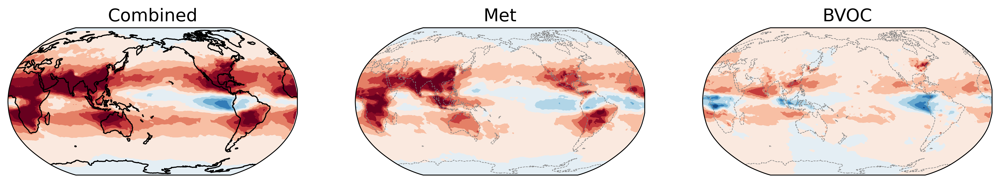

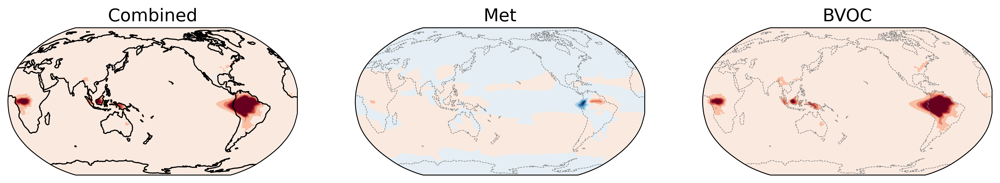

In [15]:
base_indxs = [2,2,4]
warming_indxs = [5,3,5]
labels = ['Combined','Met','BVOC']
indxs = [0,2]
fig = plt.figure(figsize=(16,3),dpi=500)

spc_indx = budget_labels.index('OH PROD')

fig = plt.figure(figsize=(16,3),dpi=500)

for i in range(3): 
    ax = fig.add_subplot(131+i,projection=ccrs.Robinson(central_longitude=180),facecolor='white',frameon=True)
    plot=plt.contourf(lon,lat,budget_comb[warming_indxs[i],spc_indx,:,:]/1e6 - budget_comb[base_indxs[i],spc_indx,:,:]/1e6,levels=np.linspace(-0.2,0.2,11),
                      cmap=plt.cm.RdBu_r,transform=ccrs.PlateCarree(),extend='both') 
    #if i ==1:
    #    cb=plt.colorbar(plot,ax=ax,shrink=1, orientation = 'horizontal',label='Changes in OH production rate (10$^6$ molec cm$^{-3}$ s$^{-1}$)')
    #plt.title('Year {}, month {}'.format(1950+i_year, 1+i_month))
    ax.set_title(labels[i],fontsize=16)
    #ax.set_title(output_strs[i],fontsize=8)
    if i == 0:
        ax.coastlines()
    else:
        ax.coastlines(linestyle='--',color='gray',linewidth=0.5)

spc_indx = budget_labels.index('OH Loss')
fig = plt.figure(figsize=(16,3),dpi=500)

for i in range(3): 
    ax = fig.add_subplot(131+i,projection=ccrs.Robinson(central_longitude=180),facecolor='white',frameon=True)
    plot=plt.contourf(lon,lat,budget_freq_comb[warming_indxs[i],spc_indx,:,:]- budget_freq_comb[base_indxs[i],spc_indx,:,:],levels=np.linspace(-1,1,11),
                      cmap=plt.cm.RdBu_r,transform=ccrs.PlateCarree(),extend='both') 
    #if i ==1:
    #    cb=plt.colorbar(plot,ax=ax,shrink=1, orientation = 'horizontal',label='Changes in OH loss frequency (s$^{-1}$)')
    #plt.title('Year {}, month {}'.format(1950+i_year, 1+i_month))
    ax.set_title(labels[i],fontsize=16)
    #ax.set_title(output_strs[i],fontsize=8)
    if i == 0:
        ax.coastlines()
    else:
        ax.coastlines(linestyle='--',color='gray',linewidth=0.5)

<Figure size 8000x1500 with 0 Axes>

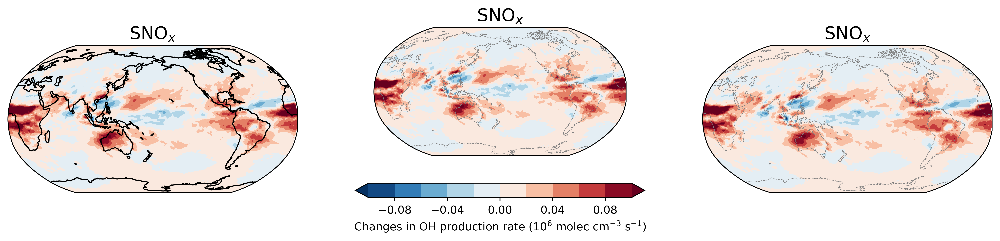

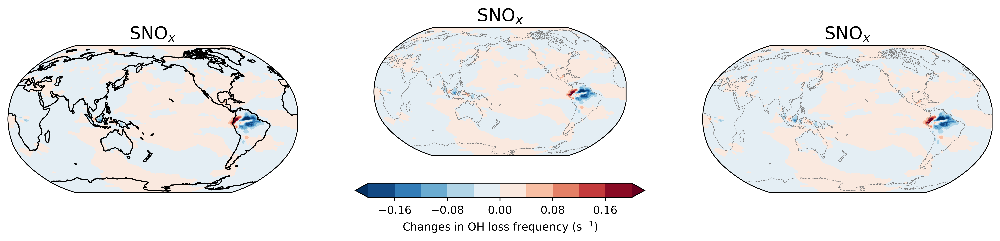

In [13]:
base_indxs = [3,3,3]
warming_indxs = [4,4,4]
labels = ['SNO$_x$','SNO$_x$','SNO$_x$']
indxs = [0,2]
fig = plt.figure(figsize=(16,3),dpi=500)

spc_indx = budget_labels.index('OH PROD')

fig = plt.figure(figsize=(16,3),dpi=500)

for i in range(3): 
    ax = fig.add_subplot(131+i,projection=ccrs.Robinson(central_longitude=180),facecolor='white',frameon=True)
    plot=plt.contourf(lon,lat,budget_comb[warming_indxs[i],spc_indx,:,:]/1e6 - budget_comb[base_indxs[i],spc_indx,:,:]/1e6,levels=np.linspace(-0.1,0.1,11),
                      cmap=plt.cm.RdBu_r,transform=ccrs.PlateCarree(),extend='both') 
    if i ==1:
        cb=plt.colorbar(plot,ax=ax,shrink=1, orientation = 'horizontal',label='Changes in OH production rate (10$^6$ molec cm$^{-3}$ s$^{-1}$)')
    #plt.title('Year {}, month {}'.format(1950+i_year, 1+i_month))
    ax.set_title(labels[i],fontsize=16)
    #ax.set_title(output_strs[i],fontsize=8)
    if i == 0:
        ax.coastlines()
    else:
        ax.coastlines(linestyle='--',color='gray',linewidth=0.5)

spc_indx = budget_labels.index('OH Loss')
fig = plt.figure(figsize=(16,3),dpi=500)

for i in range(3): 
    ax = fig.add_subplot(131+i,projection=ccrs.Robinson(central_longitude=180),facecolor='white',frameon=True)
    plot=plt.contourf(lon,lat,budget_freq_comb[warming_indxs[i],spc_indx,:,:]- budget_freq_comb[base_indxs[i],spc_indx,:,:],levels=np.linspace(-0.2,0.2,11),
                      cmap=plt.cm.RdBu_r,transform=ccrs.PlateCarree(),extend='both') 
    if i ==1:
        cb=plt.colorbar(plot,ax=ax,shrink=1, orientation = 'horizontal',label='Changes in OH loss frequency (s$^{-1}$)')
    #plt.title('Year {}, month {}'.format(1950+i_year, 1+i_month))
    ax.set_title(labels[i],fontsize=16)
    #ax.set_title(output_strs[i],fontsize=8)
    if i == 0:
        ax.coastlines()
    else:
        ax.coastlines(linestyle='--',color='gray',linewidth=0.5)